In [1]:
import tensorflow as tf
import librys
import librypre

print("TensorFlow version :", tf.__version__)
print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))

TensorFlow version : 2.3.1
Num GPUs Available:  1


# Load Dataset and Overview

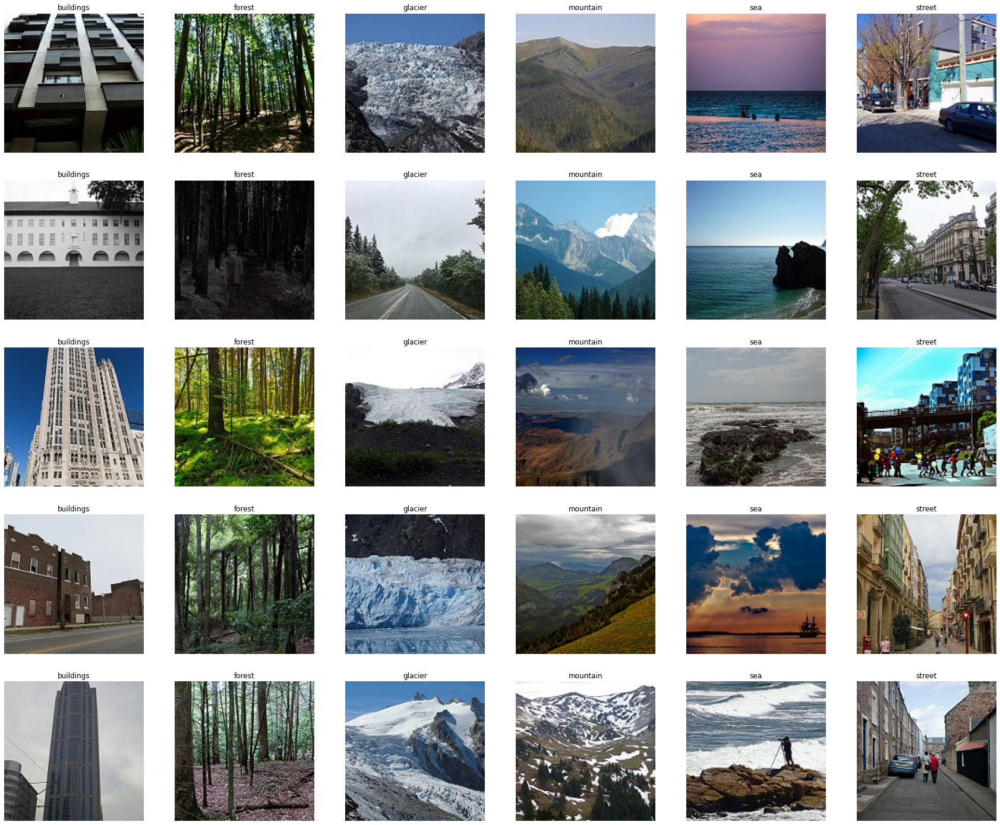

In [2]:
librys.trainSampleView()

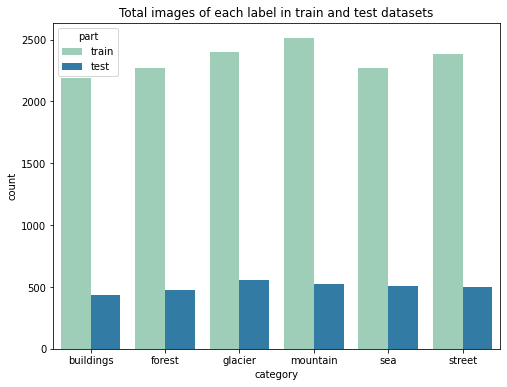

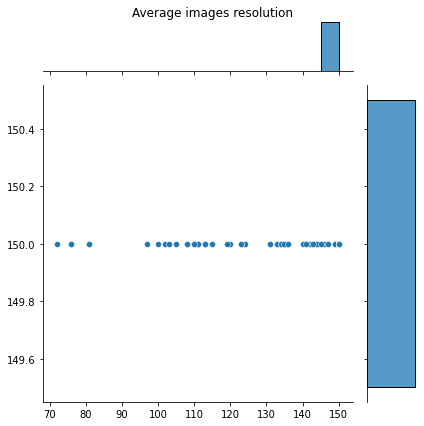

In [3]:
img_shape = librys.dataInfo(img_res=True)

# Images Preprocessing

In [4]:
param_augment = {"rotation_range":20,"width_shift_range":0.2,"height_shift_range":0.2,"shear_range":0.2,"brightness_range":(0.1,0.9),"zoom_range":[0.2,1.5],"channel_shift_range":150,"horizontal_flip":True,"fill_mode":'nearest'}

categories, total_categories, train_data, test_data, labels_dict = librys.dataPrep(image_shape=(img_shape[0],img_shape[1]),
                                                                                    color_mode='rgb',
                                                                                    batch_size=64,
                                                                                    class_mode='categorical',
                                                                                    image_augmentation=param_augment)

Found 14034 images belonging to 6 classes.
Found 3000 images belonging to 6 classes.


---
---
# (InceptionV3) Import and Train Pre-trained Model

#### https://storage.googleapis.com/mledu-datasets/inception_v3_weights_tf_dim_ordering_tf_kernels_notop.h5

In [5]:
IV3_model = librypre.inceptionV3Modeling(input_shape=img_shape, output_label=total_categories, verbose=True)

][0]     
__________________________________________________________________________________________________
conv2d_41 (Conv2D)              (None, 7, 7, 160)    122880      mixed4[0][0]                     
__________________________________________________________________________________________________
conv2d_46 (Conv2D)              (None, 7, 7, 160)    179200      activation_45[0][0]              
__________________________________________________________________________________________________
batch_normalization_41 (BatchNo (None, 7, 7, 160)    480         conv2d_41[0][0]                  
__________________________________________________________________________________________________
batch_normalization_46 (BatchNo (None, 7, 7, 160)    480         conv2d_46[0][0]                  
__________________________________________________________________________________________________
activation_41 (Activation)      (None, 7, 7, 160)    0           batch_normalization_41[0][0]     


In [6]:
IV3_trained_model, history = librys.trainModel(model=IV3_model,
                                              data_train=train_data,
                                              data_validation=test_data,
                                              early_stop=True,
                                              patience=10,
                                              checkpoint=True,
                                              model_name="InceptionV3_1",
                                              num_epochs=100,
                                              verbose=1)

Epoch 1/100
219/219 [==============================] - ETA: 0s - loss: 1.0982 - accuracy: 0.7019
Epoch 00001: val_loss improved from inf to 0.67911, saving model to models\InceptionV3_1.h5
219/219 [==============================] - 87s 396ms/step - loss: 1.0982 - accuracy: 0.7019 - val_loss: 0.6791 - val_accuracy: 0.8957
Epoch 2/100
219/219 [==============================] - ETA: 0s - loss: 0.9050 - accuracy: 0.7704
Epoch 00002: val_loss improved from 0.67911 to 0.67211, saving model to models\InceptionV3_1.h5
219/219 [==============================] - 87s 396ms/step - loss: 0.9050 - accuracy: 0.7704 - val_loss: 0.6721 - val_accuracy: 0.8882
Epoch 3/100
219/219 [==============================] - ETA: 0s - loss: 0.8832 - accuracy: 0.7800
Epoch 00003: val_loss improved from 0.67211 to 0.64700, saving model to models\InceptionV3_1.h5
219/219 [==============================] - 87s 395ms/step - loss: 0.8832 - accuracy: 0.7800 - val_loss: 0.6470 - val_accuracy: 0.9066
Epoch 4/100
219/219 [==

# (InceptionV3) Evaluate The Model

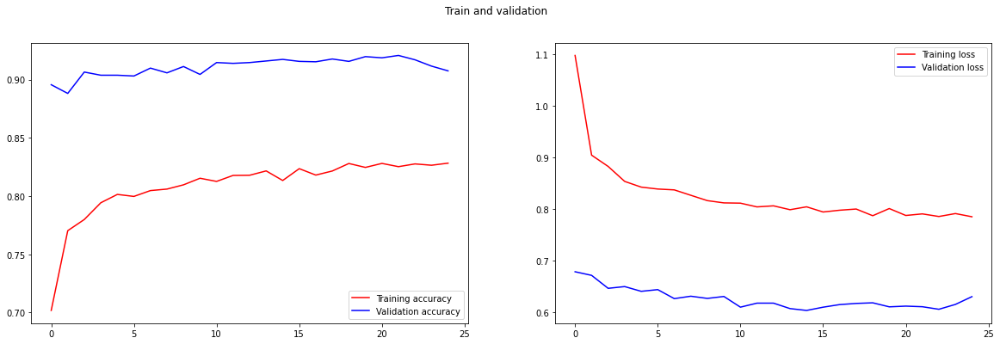




47/47 [==============================] - 3s 71ms/step - loss: 0.6054 - accuracy: 0.9173
validation accuracy : 91.73333048820496%
validation loss : 0.6054002642631531


In [7]:
librys.modelEvaluation(model=IV3_trained_model, history=history, data_validation=test_data)

              precision    recall  f1-score   support

   buildings       0.91      0.93      0.92       437
      forest       1.00      0.98      0.99       474
     glacier       0.86      0.87      0.87       553
    mountain       0.88      0.84      0.86       525
         sea       0.93      0.95      0.94       510
      street       0.94      0.94      0.94       501

    accuracy                           0.92      3000
   macro avg       0.92      0.92      0.92      3000
weighted avg       0.92      0.92      0.92      3000





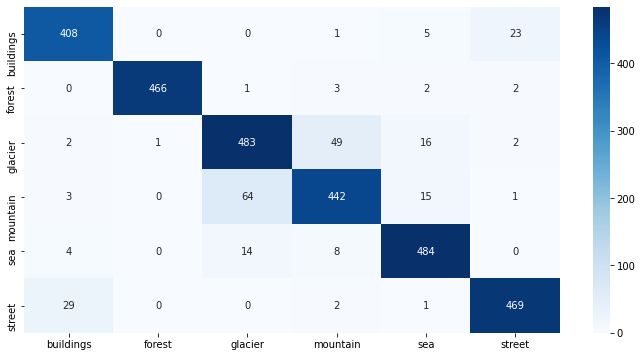

In [8]:
librys.modelReport(model=IV3_trained_model, data_validation=test_data)

# (InceptionV3) Predict New Unlabeled Images

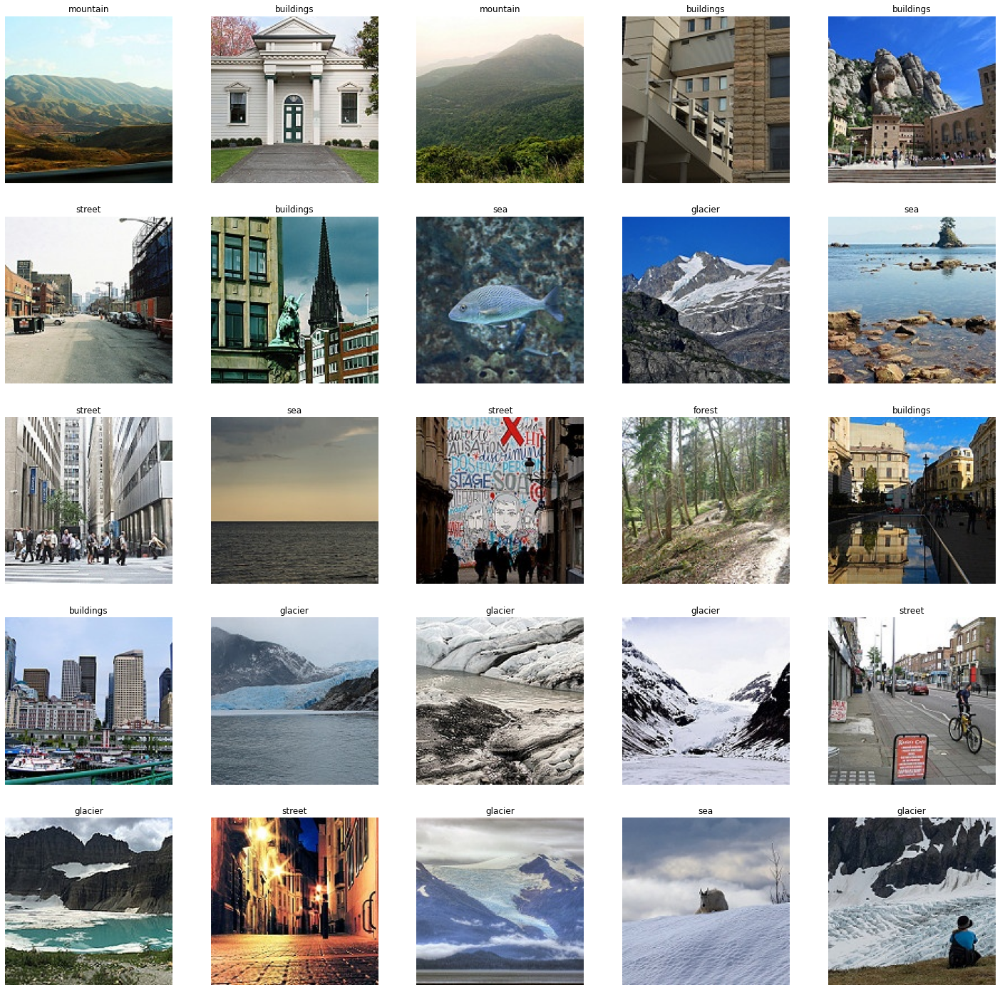

In [9]:
librys.predictNewImagesInBatch(model=IV3_trained_model, categories_dict=labels_dict, image_shape=img_shape)

---
---
# (VGG16) Import and Train Pre-trained Model

#### https://github.com/fchollet/deep-learning-models/releases/download/v0.1/vgg16_weights_tf_dim_ordering_tf_kernels_notop.h5

In [10]:
VGG16_model = librypre.vgg16Modeling(input_shape=img_shape, output_label=total_categories, verbose=True)

Model: "functional_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 149, 150, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 149, 150, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 149, 150, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 74, 75, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 74, 75, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 74, 75, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 37, 37, 128)      

In [11]:
VGG16_trained_model, history = librys.trainModel(model=VGG16_model,
                                                data_train=train_data,
                                                data_validation=test_data,
                                                early_stop=True,
                                                patience=10,
                                                checkpoint=True,
                                                model_name="VGG16_1",
                                                num_epochs=100,
                                                verbose=1)

h 00017: val_loss did not improve from 0.75584
219/219 [==============================] - 90s 410ms/step - loss: 1.0640 - accuracy: 0.6787 - val_loss: 0.7832 - val_accuracy: 0.8315
Epoch 18/100
219/219 [==============================] - ETA: 0s - loss: 1.0595 - accuracy: 0.6807
Epoch 00018: val_loss did not improve from 0.75584
219/219 [==============================] - 90s 410ms/step - loss: 1.0595 - accuracy: 0.6807 - val_loss: 0.7598 - val_accuracy: 0.8543
Epoch 19/100
219/219 [==============================] - ETA: 0s - loss: 1.0536 - accuracy: 0.6854
Epoch 00019: val_loss did not improve from 0.75584
219/219 [==============================] - 90s 410ms/step - loss: 1.0536 - accuracy: 0.6854 - val_loss: 0.7718 - val_accuracy: 0.8356
Epoch 20/100
219/219 [==============================] - ETA: 0s - loss: 1.0475 - accuracy: 0.6884
Epoch 00020: val_loss improved from 0.75584 to 0.74127, saving model to models\VGG16_1.h5
219/219 [==============================] - 94s 429ms/step - loss:

# (VGG16) Evaluate The Model

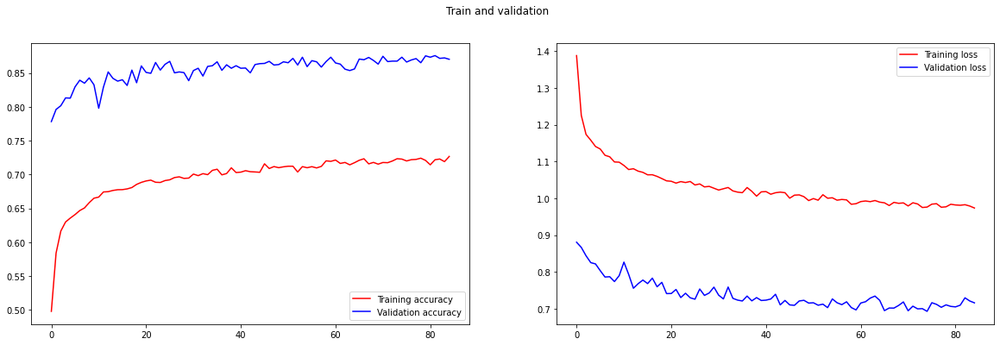




47/47 [==============================] - 6s 117ms/step - loss: 0.6945 - accuracy: 0.8713
validation accuracy : 87.1333360671997%
validation loss : 0.6945241093635559


In [12]:
librys.modelEvaluation(model=VGG16_trained_model, history=history, data_validation=test_data)

              precision    recall  f1-score   support

   buildings       0.85      0.92      0.89       437
      forest       0.94      0.99      0.96       474
     glacier       0.82      0.81      0.81       553
    mountain       0.83      0.77      0.80       525
         sea       0.89      0.87      0.88       510
      street       0.91      0.88      0.90       501

    accuracy                           0.87      3000
   macro avg       0.87      0.88      0.87      3000
weighted avg       0.87      0.87      0.87      3000





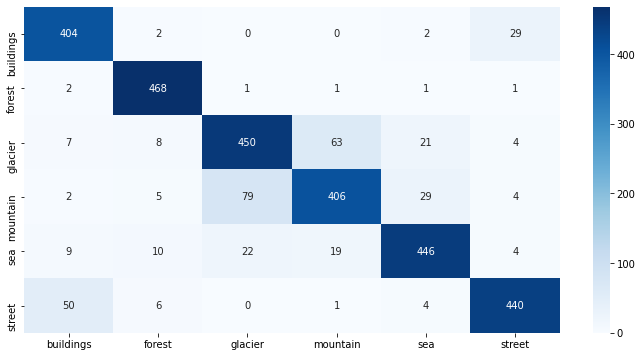

In [13]:
librys.modelReport(model=VGG16_trained_model, data_validation=test_data)

# (VGG16) Predict New Unlabeled Images

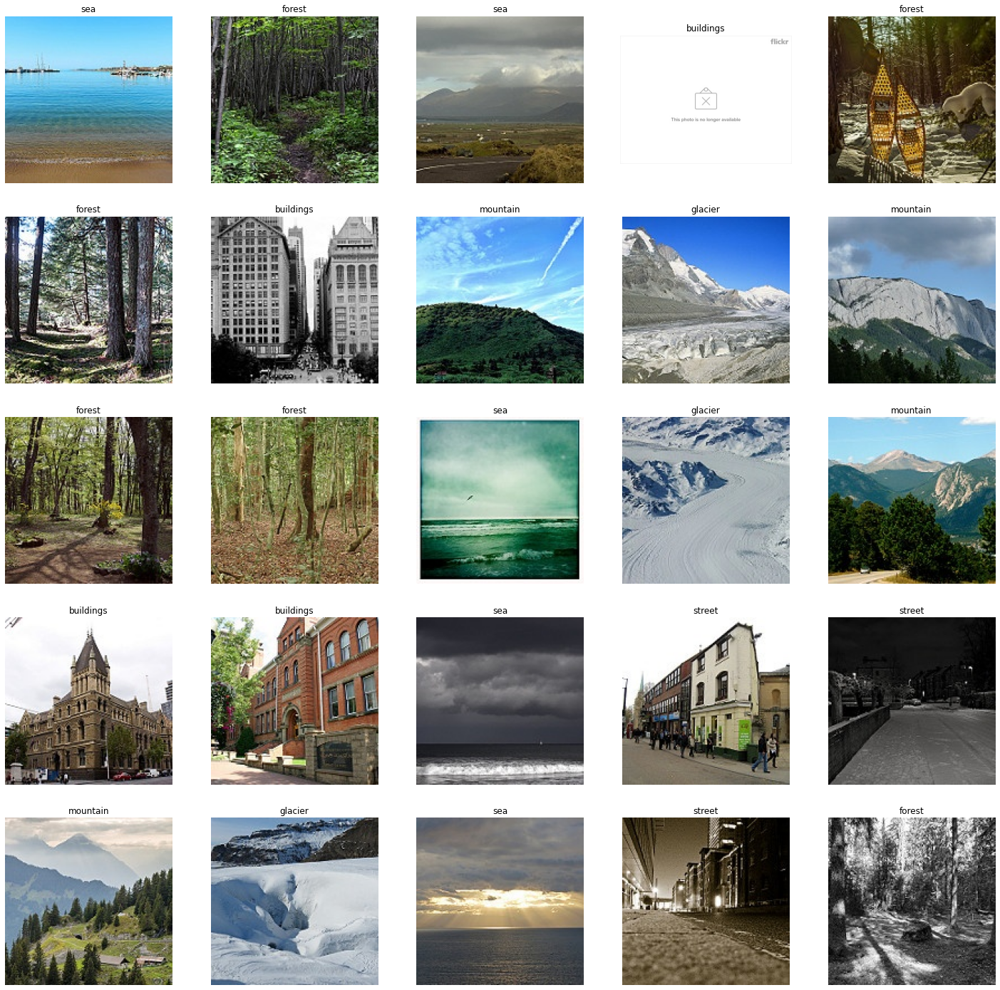

In [14]:
librys.predictNewImagesInBatch(model=VGG16_trained_model, categories_dict=labels_dict, image_shape=img_shape)

---
---
# (ResNet50) Import and Train Pre-trained Model

#### https://github.com/keras-team/keras-applications/releases/download/resnet/resnet50_weights_tf_dim_ordering_tf_kernels_notop.h5

In [15]:
ResNet50_model = librypre.resNet50Modeling(input_shape=img_shape, output_label=total_categories, verbose=True)

][0]        
__________________________________________________________________________________________________
conv4_block1_1_relu (Activation (None, 10, 10, 256)  0           conv4_block1_1_bn[0][0]          
__________________________________________________________________________________________________
conv4_block1_2_conv (Conv2D)    (None, 10, 10, 256)  590080      conv4_block1_1_relu[0][0]        
__________________________________________________________________________________________________
conv4_block1_2_bn (BatchNormali (None, 10, 10, 256)  1024        conv4_block1_2_conv[0][0]        
__________________________________________________________________________________________________
conv4_block1_2_relu (Activation (None, 10, 10, 256)  0           conv4_block1_2_bn[0][0]          
__________________________________________________________________________________________________
conv4_block1_0_conv (Conv2D)    (None, 10, 10, 1024) 525312      conv3_block4_out[0][0]         

In [16]:
ResNet50_trained_model, history = librys.trainModel(model=ResNet50_model,
                                                data_train=train_data,
                                                data_validation=test_data,
                                                early_stop=True,
                                                patience=10,
                                                checkpoint=True,
                                                model_name="ResNet50_1",
                                                num_epochs=150,
                                                verbose=1)

Epoch 1/150
219/219 [==============================] - ETA: 0s - loss: 2.3847 - accuracy: 0.2843
Epoch 00001: val_loss improved from inf to 2.29335, saving model to models\ResNet50_1.h5
219/219 [==============================] - 98s 447ms/step - loss: 2.3847 - accuracy: 0.2843 - val_loss: 2.2934 - val_accuracy: 0.1831
Epoch 2/150
219/219 [==============================] - ETA: 0s - loss: 1.5189 - accuracy: 0.4142
Epoch 00002: val_loss improved from 2.29335 to 1.51912, saving model to models\ResNet50_1.h5
219/219 [==============================] - 97s 443ms/step - loss: 1.5189 - accuracy: 0.4142 - val_loss: 1.5191 - val_accuracy: 0.3376
Epoch 3/150
219/219 [==============================] - ETA: 0s - loss: 1.3832 - accuracy: 0.4603
Epoch 00003: val_loss improved from 1.51912 to 1.04356, saving model to models\ResNet50_1.h5
219/219 [==============================] - 97s 443ms/step - loss: 1.3832 - accuracy: 0.4603 - val_loss: 1.0436 - val_accuracy: 0.6026
Epoch 4/150
219/219 [===========

# (ResNet50) Evaluate The Model

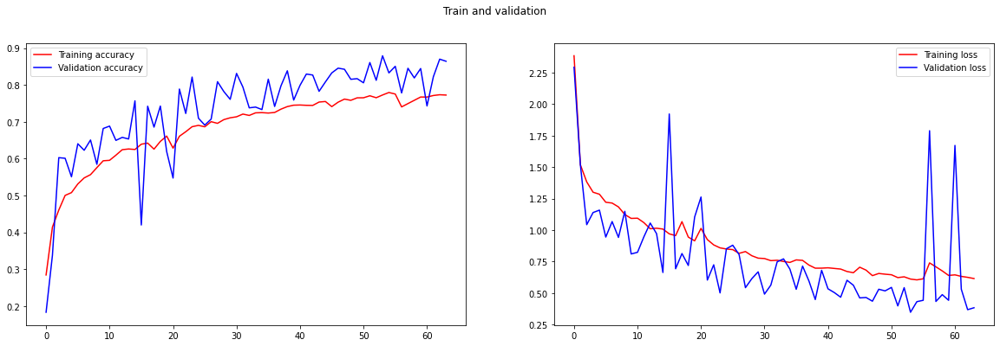




47/47 [==============================] - 5s 103ms/step - loss: 0.3470 - accuracy: 0.8793
validation accuracy : 87.93333172798157%
validation loss : 0.34698209166526794


In [17]:
librys.modelEvaluation(model=ResNet50_trained_model, history=history, data_validation=test_data)

              precision    recall  f1-score   support

   buildings       0.89      0.81      0.85       437
      forest       0.98      0.98      0.98       474
     glacier       0.81      0.86      0.83       553
    mountain       0.84      0.82      0.83       525
         sea       0.92      0.88      0.90       510
      street       0.86      0.93      0.89       501

    accuracy                           0.88      3000
   macro avg       0.88      0.88      0.88      3000
weighted avg       0.88      0.88      0.88      3000





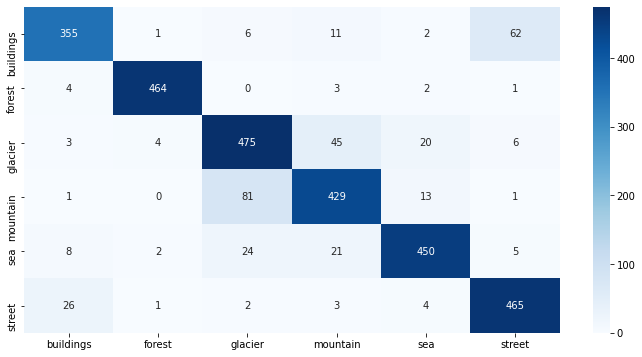

In [18]:
librys.modelReport(model=ResNet50_trained_model, data_validation=test_data)

# (ResNet50) Predict New Unlabeled Images

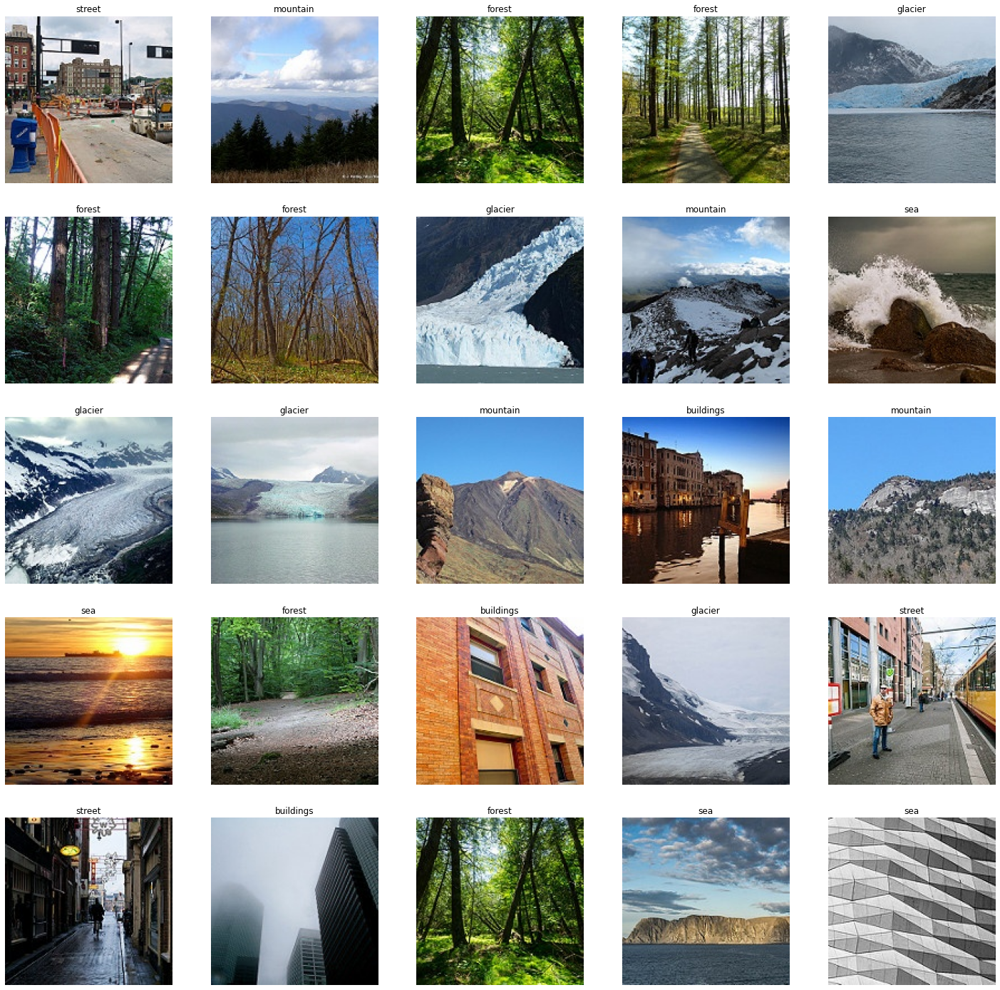

In [19]:
librys.predictNewImagesInBatch(model=ResNet50_trained_model, categories_dict=labels_dict, image_shape=img_shape)